Ref: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from glob import glob

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [2]:
# Root directory for dataset
dataroot = "dataset"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 16

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 150

# Size of feature maps in generator
ngf = 128

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 200

# Learning rate for optimizers
lr = 0.0005

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

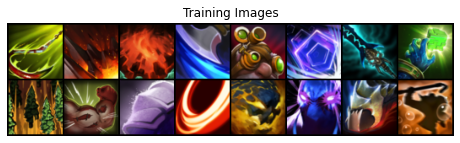

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(150, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()


In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [8]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(image_size, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [10]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/200][0/85]	Loss_D: 1.7738	Loss_G: 18.4151	D(x): 0.6068	D(G(z)): 0.6253 / 0.0000
[0/200][50/85]	Loss_D: 1.0000	Loss_G: 4.4200	D(x): 0.7431	D(G(z)): 0.3403 / 0.0143
[1/200][0/85]	Loss_D: 0.5980	Loss_G: 5.1695	D(x): 0.7075	D(G(z)): 0.1115 / 0.0141
[1/200][50/85]	Loss_D: 2.0853	Loss_G: 6.7895	D(x): 0.6834	D(G(z)): 0.6840 / 0.0014
[2/200][0/85]	Loss_D: 1.1481	Loss_G: 4.5359	D(x): 0.4777	D(G(z)): 0.0413 / 0.0378
[2/200][50/85]	Loss_D: 0.8069	Loss_G: 1.5341	D(x): 0.6044	D(G(z)): 0.0918 / 0.2807
[3/200][0/85]	Loss_D: 0.6610	Loss_G: 6.0640	D(x): 0.9168	D(G(z)): 0.3043 / 0.0040
[3/200][50/85]	Loss_D: 0.2386	Loss_G: 4.4581	D(x): 0.9031	D(G(z)): 0.1140 / 0.0392
[4/200][0/85]	Loss_D: 2.2951	Loss_G: 0.6904	D(x): 0.1380	D(G(z)): 0.0144 / 0.5644
[4/200][50/85]	Loss_D: 2.6416	Loss_G: 7.1924	D(x): 0.9699	D(G(z)): 0.9109 / 0.0032
[5/200][0/85]	Loss_D: 0.6341	Loss_G: 3.7410	D(x): 0.9183	D(G(z)): 0.3628 / 0.0346
[5/200][50/85]	Loss_D: 0.4661	Loss_G: 4.6110	D(x): 0.9012	D(G(z)):

[49/200][50/85]	Loss_D: 0.2361	Loss_G: 4.5567	D(x): 0.9119	D(G(z)): 0.1161 / 0.0219
[50/200][0/85]	Loss_D: 0.4522	Loss_G: 4.1428	D(x): 0.8736	D(G(z)): 0.2389 / 0.0215
[50/200][50/85]	Loss_D: 0.4296	Loss_G: 4.6198	D(x): 0.9778	D(G(z)): 0.2768 / 0.0164
[51/200][0/85]	Loss_D: 0.5315	Loss_G: 5.2758	D(x): 0.8802	D(G(z)): 0.2524 / 0.0097
[51/200][50/85]	Loss_D: 0.3268	Loss_G: 3.2447	D(x): 0.8354	D(G(z)): 0.1067 / 0.0594
[52/200][0/85]	Loss_D: 0.3252	Loss_G: 3.9510	D(x): 0.8690	D(G(z)): 0.1238 / 0.0684
[52/200][50/85]	Loss_D: 0.6557	Loss_G: 6.3925	D(x): 0.8893	D(G(z)): 0.3316 / 0.0023
[53/200][0/85]	Loss_D: 0.5078	Loss_G: 4.8971	D(x): 0.8156	D(G(z)): 0.1128 / 0.0184
[53/200][50/85]	Loss_D: 0.2438	Loss_G: 4.8814	D(x): 0.9560	D(G(z)): 0.1710 / 0.0117
[54/200][0/85]	Loss_D: 0.3870	Loss_G: 4.9486	D(x): 0.9351	D(G(z)): 0.2199 / 0.0116
[54/200][50/85]	Loss_D: 0.8487	Loss_G: 1.9356	D(x): 0.5651	D(G(z)): 0.1341 / 0.1905
[55/200][0/85]	Loss_D: 0.6039	Loss_G: 2.9094	D(x): 0.6720	D(G(z)): 0.0618 / 0.083

[99/200][0/85]	Loss_D: 0.0587	Loss_G: 5.9098	D(x): 0.9925	D(G(z)): 0.0464 / 0.0077
[99/200][50/85]	Loss_D: 0.0477	Loss_G: 5.3180	D(x): 0.9683	D(G(z)): 0.0132 / 0.0100
[100/200][0/85]	Loss_D: 0.0264	Loss_G: 5.6705	D(x): 0.9879	D(G(z)): 0.0138 / 0.0098
[100/200][50/85]	Loss_D: 0.0611	Loss_G: 5.5559	D(x): 0.9701	D(G(z)): 0.0278 / 0.0073
[101/200][0/85]	Loss_D: 0.0275	Loss_G: 5.2447	D(x): 0.9944	D(G(z)): 0.0214 / 0.0094
[101/200][50/85]	Loss_D: 0.0606	Loss_G: 8.1136	D(x): 0.9893	D(G(z)): 0.0420 / 0.0018
[102/200][0/85]	Loss_D: 0.0783	Loss_G: 5.1570	D(x): 0.9482	D(G(z)): 0.0211 / 0.0146
[102/200][50/85]	Loss_D: 0.0411	Loss_G: 5.9713	D(x): 0.9694	D(G(z)): 0.0095 / 0.0061
[103/200][0/85]	Loss_D: 0.1490	Loss_G: 6.6332	D(x): 0.9984	D(G(z)): 0.1007 / 0.0023
[103/200][50/85]	Loss_D: 0.1262	Loss_G: 6.5896	D(x): 0.9565	D(G(z)): 0.0607 / 0.0033
[104/200][0/85]	Loss_D: 0.0726	Loss_G: 7.0207	D(x): 0.9941	D(G(z)): 0.0613 / 0.0026
[104/200][50/85]	Loss_D: 0.0821	Loss_G: 4.8514	D(x): 0.9467	D(G(z)): 0.01

[147/200][50/85]	Loss_D: 0.0732	Loss_G: 8.9934	D(x): 0.9408	D(G(z)): 0.0023 / 0.0011
[148/200][0/85]	Loss_D: 0.0881	Loss_G: 8.6900	D(x): 0.9506	D(G(z)): 0.0213 / 0.0016
[148/200][50/85]	Loss_D: 0.0187	Loss_G: 7.7481	D(x): 0.9846	D(G(z)): 0.0029 / 0.0020
[149/200][0/85]	Loss_D: 0.1629	Loss_G: 6.2890	D(x): 0.8886	D(G(z)): 0.0008 / 0.0052
[149/200][50/85]	Loss_D: 0.0428	Loss_G: 8.8387	D(x): 0.9729	D(G(z)): 0.0132 / 0.0007
[150/200][0/85]	Loss_D: 0.0382	Loss_G: 9.1078	D(x): 0.9699	D(G(z)): 0.0016 / 0.0012
[150/200][50/85]	Loss_D: 0.0281	Loss_G: 7.4499	D(x): 0.9765	D(G(z)): 0.0036 / 0.0027
[151/200][0/85]	Loss_D: 0.1133	Loss_G: 7.5622	D(x): 0.9199	D(G(z)): 0.0019 / 0.0021
[151/200][50/85]	Loss_D: 0.0307	Loss_G: 10.9763	D(x): 0.9726	D(G(z)): 0.0002 / 0.0003
[152/200][0/85]	Loss_D: 0.0271	Loss_G: 7.8158	D(x): 0.9829	D(G(z)): 0.0079 / 0.0027
[152/200][50/85]	Loss_D: 0.0280	Loss_G: 7.8139	D(x): 0.9847	D(G(z)): 0.0119 / 0.0079
[153/200][0/85]	Loss_D: 0.0957	Loss_G: 7.9703	D(x): 0.9809	D(G(z)): 0

[196/200][0/85]	Loss_D: 0.1165	Loss_G: 9.9158	D(x): 0.9980	D(G(z)): 0.0793 / 0.0003
[196/200][50/85]	Loss_D: 0.1317	Loss_G: 10.1982	D(x): 0.9996	D(G(z)): 0.0990 / 0.0002
[197/200][0/85]	Loss_D: 0.0176	Loss_G: 7.5605	D(x): 0.9906	D(G(z)): 0.0077 / 0.0015
[197/200][50/85]	Loss_D: 0.0591	Loss_G: 7.3177	D(x): 0.9573	D(G(z)): 0.0028 / 0.0036
[198/200][0/85]	Loss_D: 0.0159	Loss_G: 8.5797	D(x): 0.9923	D(G(z)): 0.0077 / 0.0013
[198/200][50/85]	Loss_D: 0.0318	Loss_G: 14.0627	D(x): 0.9902	D(G(z)): 0.0203 / 0.0008
[199/200][0/85]	Loss_D: 0.1318	Loss_G: 19.9583	D(x): 0.9966	D(G(z)): 0.0738 / 0.0005
[199/200][50/85]	Loss_D: 0.1796	Loss_G: 7.9775	D(x): 0.9449	D(G(z)): 0.0569 / 0.0019


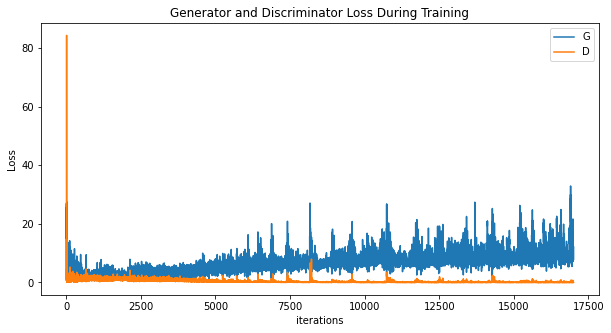

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21501570 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


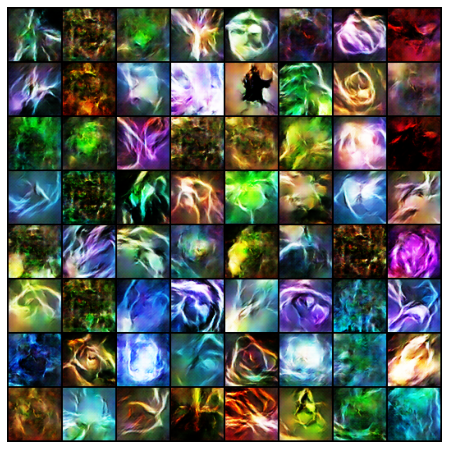

In [12]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

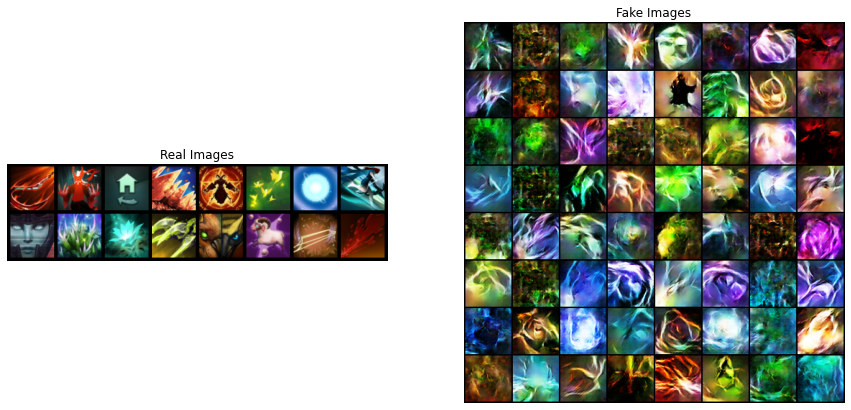

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [14]:
# Save fake images
if not os.path.exists('output/'):
    os.mkdir('output/')

version = len(glob("output/*/"))
os.mkdir(f'output/{version}')
print(f"Output version: {version}")

for img_no in range(fake.shape[0]):
    vutils.save_image(fake[img_no],f'output/{version}/{img_no}.png', normalize=True)

# Save animation
Writer = animation.writers['ffmpeg']
writer = Writer(fps=4, metadata=dict(artist='DoubleGremlin181'), bitrate=10000)
ani.save(f'output/{version}/animation.mp4', writer=writer)

Output version: 8
